In [1]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import scipy.stats as st
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.metrics import confusion_matrix
import matplotlib.mlab as mlab
# %matplotlib inline



# Python libraries
# import pandas as pd
# import numpy as np
# import seaborn as sns
# import matplotlib.pyplot as plt
# %matplotlib inline
import itertools
from itertools import chain
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score, learning_curve, train_test_split
from sklearn.metrics import precision_score, recall_score, confusion_matrix, roc_curve, precision_recall_curve, accuracy_score
import warnings
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

warnings.filterwarnings('ignore') #ignore warning messages 

In [2]:
# data_df=pd.read_csv("C:/Users/gold/Desktop/models/inputdata52.csv")
data = pd.read_csv("C:/Users/gold/Desktop/models/datas/data.csv")
# data.drop(['id'],axis=1,inplace=True)
data.head()

,id,sex,age,profession,hypertension,diabetes,coronary heart disease,stroke,others,Treatment time period,...,diarrhea and fever,haematemesis,tenesmus,syncope,Persistent pain,other property of pain,Pain scores,pressing pain and rebounding pain,abdominal wall tensity,level
0,1,1,3,0,1,0,0,1,1,2,...,0,0,0,0,1,2,7,1,1,1
1,2,2,3,0,1,1,1,1,1,2,...,0,1,0,0,2,1,2,1,0,1
2,3,2,3,0,1,1,1,0,1,2,...,0,1,0,0,2,1,1,0,0,1
3,4,1,3,0,1,0,1,1,0,1,...,0,1,0,0,2,1,1,0,0,2
4,5,2,3,0,1,0,0,0,1,2,...,1,1,0,0,2,1,1,0,0,2


In [3]:
print(list(data.columns))

['id', 'sex', 'age', 'profession', 'hypertension', 'diabetes', 'coronary heart disease', 'stroke', 'others', 'Treatment time period', 'Temperature', 'Pulse', 'RR', 'BP', 'SPO2 ', 'anemic appearance', 'complexion', 'consciousness', 'Way to enter wards', 'borborygmus', 'obvious cause', 'pain position', 'nausea and vomiting', 'diarrhea and fever', 'haematemesis', 'tenesmus', 'syncope', 'Persistent pain', 'other property of pain', 'Pain scores', 'pressing pain and rebounding pain', 'abdominal wall tensity', 'level']


In [4]:
# Missing values
# import plotly.offline as py
# import plotly.graph_objs as go

null_feat = pd.DataFrame(len(data['id']) - data.isnull().sum(), columns = ['Count'])

trace = go.Bar(x = null_feat.index, y = null_feat['Count'] ,opacity = 0.8, marker=dict(color = 'lightgrey',
        line=dict(color='#000000',width=1.5)))

layout = dict(title =  "Missing Values")
                    
fig = dict(data = [trace], layout=layout)
py.iplot(fig)
fig
# py.plot(fig)

{'data': [Bar({
      'marker': {'color': 'lightgrey', 'line': {'color': '#000000', 'width': 1.5}},
      'opacity': 0.8,
      'x': array(['id', 'sex', 'age', 'profession', 'hypertension', 'diabetes',
                  'coronary heart disease', 'stroke', 'others', 'Treatment time period',
                  'Temperature', 'Pulse', 'RR', 'BP', 'SPO2 ', 'anemic appearance',
                  'complexion', 'consciousness', 'Way to enter wards', 'borborygmus',
                  'obvious cause', 'pain position', 'nausea and vomiting',
                  'diarrhea and fever', 'haematemesis', 'tenesmus', 'syncope',
                  'Persistent pain', 'other property of pain', 'Pain scores',
                  'pressing pain and rebounding pain', 'abdominal wall tensity', 'level'],
                 dtype=object),
      'y': array([3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231,
                  3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231, 3231,
    

In [5]:
# Drop useless variables
# data = data.drop(['Unnamed: 32','id'],axis = 1)
data.drop(['id'],axis=1,inplace=True)

# Reassign target
# data.level.replace(to_replace = dict(1 = I, 2 = II, 3 = III, 4 = IV), inplace = True)

In [6]:
#correlation
correlation = data.corr()
#tick labels
matrix_cols = correlation.columns.tolist()
#convert to array
corr_array  = np.array(correlation)

In [7]:
#Plotting
trace = go.Heatmap(z = corr_array,
                   x = matrix_cols,
                   y = matrix_cols,
                   xgap = 2,
                   ygap = 2,
                   colorscale='Viridis',
                   colorbar   = dict() ,
                  )
layout = go.Layout(dict(title = 'Correlation Matrix for variables',
                        autosize = False,
                        height  = 720,
                        width   = 800,
                        margin  = dict(r = 0 ,l = 210,
                                       t = 25,b = 210,
                                     ),
                        yaxis   = dict(tickfont = dict(size = 9)),
                        xaxis   = dict(tickfont = dict(size = 9)),
                       )
                  )
fig = go.Figure(data = [trace],layout = layout)
py.iplot(fig)
plt.savefig('C:\\Users\\gold\\Desktop\\models\\Correlation Matrix for variables.png',dpi = 3000)
#,dpi = 1000

<Figure size 432x288 with 0 Axes>

In [8]:
data.columns

Index(['sex', 'age', 'profession', 'hypertension', 'diabetes',
       'coronary heart disease', 'stroke', 'others', 'Treatment time period',
       'Temperature', 'Pulse', 'RR', 'BP', 'SPO2 ', 'anemic appearance',
       'complexion', 'consciousness', 'Way to enter wards', 'borborygmus',
       'obvious cause', 'pain position', 'nausea and vomiting',
       'diarrhea and fever', 'haematemesis', 'tenesmus', 'syncope',
       'Persistent pain', 'other property of pain', 'Pain scores',
       'pressing pain and rebounding pain', 'abdominal wall tensity', 'level'],
      dtype='object')

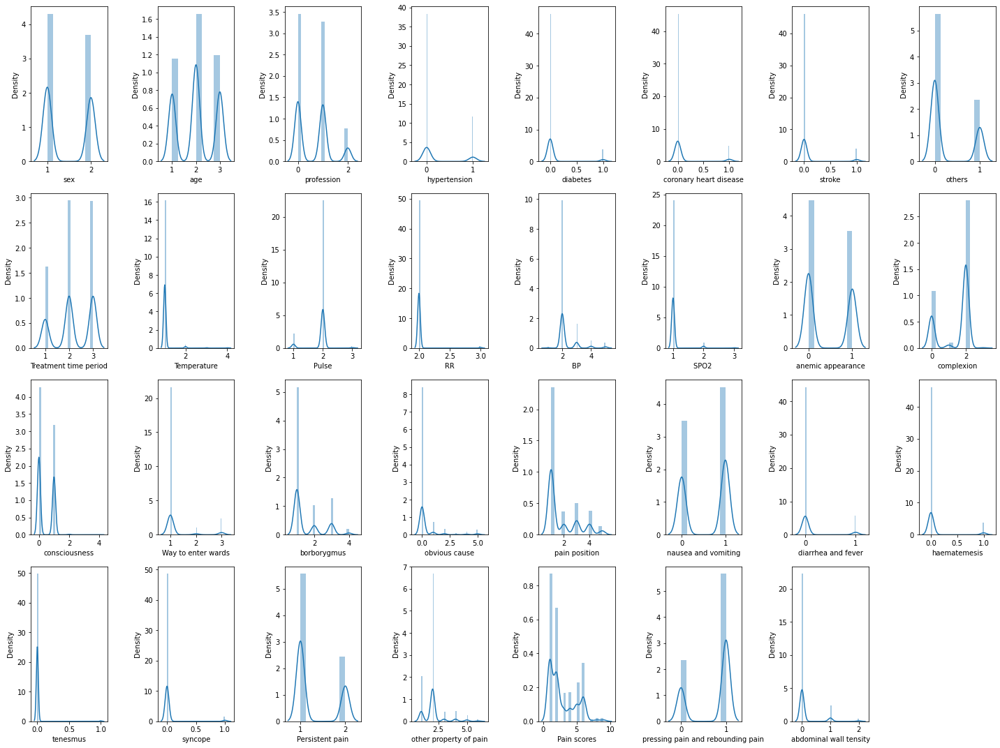

In [9]:
# ,dpi = 1000
import seaborn as sns
plt.figure(figsize = (20, 15))
plotnumber = 1

for column in data:
    if plotnumber <= 31:
        ax = plt.subplot(4, 8, plotnumber)
        sns.distplot(data[column])
        plt.xlabel(column)
        
    plotnumber += 1

plt.tight_layout()
plt.show()

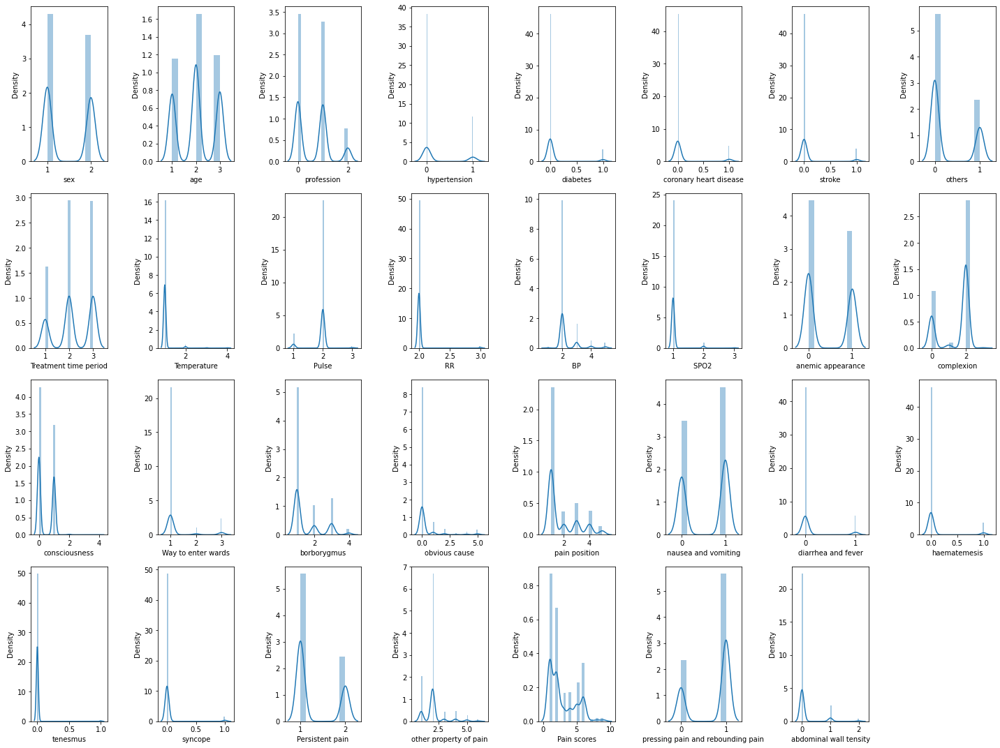

<Figure size 432x288 with 0 Axes>

In [10]:
# ,dpi = 1000
plt.figure(figsize = (20, 15))
plotnumber = 1

for column in data:
    if plotnumber <= 31:
        ax = plt.subplot(4, 8, plotnumber)
        sns.distplot(data[column])
        plt.xlabel(column)
        
    plotnumber += 1

plt.tight_layout()
plt.show()
plt.savefig('C:\\Users\\gold\\Desktop\\models\\Feature distribution figure.png',dpi = 3000)

In [11]:
# Principal Component Analysis
# Compute PCA

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

target_pca = data['level']
data_pca = data.drop('level', axis=1)

target_pca = pd.DataFrame(target_pca)

#To make a PCA, normalize data is essential
X_pca = data_pca.values
X_std = StandardScaler().fit_transform(X_pca)

pca = PCA(svd_solver='full')
pca_std = pca.fit(X_std, target_pca).transform(X_std)

pca_std = pd.DataFrame(pca_std)
pca_std = pca_std.merge(target_pca, left_index = True, right_index = True, how = 'left')
# pca_std['level'] = pca_std['level'].replace({I:'1',II:'2',III:'3',IV:'4'})

In [12]:
# explained_variance 
# PCA pie plot with 6 components (88.8%)
var_pca = pd.DataFrame(pca.explained_variance_ratio_)
var_pca = var_pca.T

#----------SUM AND DROP COMP [7:30]
col_list = list(v for v in chain(pca_std.columns[6:30])) 
var_pca['OTHERS_COMP'] = var_pca[col_list].sum(axis=1)
var_pca.drop(var_pca[col_list],axis=1,inplace=True)
var_pca = var_pca.T

In [13]:
labels = ['COMP1','COMP2','COMP3','COMP4','COMP5','COMP6', 'COMP7 - 31']
colors = ['gold', 'lightgreen', 'lightcoral', 'lightskyblue', 'lightgrey', 'orange', 'white']

trace = go.Pie(labels = labels, values = var_pca[0].values, opacity = 0.8,
               textfont=dict(size=15),
               marker=dict(colors=colors, 
                           line=dict(color='#000000', width=1.5)))


layout = dict(title =  'PCA : components and explained variance (6 comp = 88.8%)')
 
                   
fig = dict(data = [trace], layout=layout)
# plt.polt(fig)
py.iplot(fig)
# plt.show(fig)
plt.savefig('C:\\Users\\gold\\Desktop\\models\\Results of principal component analysis.jpg',dpi = 3000)


<Figure size 432x288 with 0 Axes>

In [14]:
# print("数据标准化(标准化数据（以0为中心并缩放以消除差异）)")
print("data normalization(normalized data（center on 0 and scale to eliminate differences）)")
scaler =StandardScaler()
X = scaler.fit_transform(X_std)
print(X)

数据标准化(标准化数据（以0为中心并缩放以消除差异）)
[[-0.92741772  1.2940741  -0.97372762 ...  2.12935407  0.64343172
   2.34064726]
 [ 1.07826277  1.2940741  -0.97372762 ... -0.4118083   0.64343172
  -0.33449646]
 [ 1.07826277  1.2940741  -0.97372762 ... -0.92004077 -1.55416647
  -0.33449646]
 ...
 [-0.92741772 -1.31833041  0.54028294 ... -0.4118083   0.64343172
  -0.33449646]
 [-0.92741772  1.2940741  -0.97372762 ... -0.4118083   0.64343172
  -0.33449646]
 [ 1.07826277 -0.01212815 -0.97372762 ... -0.4118083   0.64343172
   5.01579098]]


In [15]:
# encoding of the label set;From this step, dependent variable types counted as 1, 2, 3, and 4 in the data are 
# processed by the coding function and transformed to 0, 1, 2, and 3 respectively

from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
# y = encoder.fit_transform(data.level)
y = encoder.fit_transform(data[['level']])
print(y)

[0 0 0 ... 3 3 3]


In [16]:
train_X, test_X, train_y, test_y = train_test_split(X, y, test_size = 0.2, random_state = 101)
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

(2584, 31) (2584,) (647, 31) (647,)


In [17]:
from sklearn import svm
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.svm import SVC
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(svm.SVC(kernel = 'linear', probability=True, random_state = 0))

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of SVM')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of SVM.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [18]:
svm = SVC(kernel = 'linear', degree = 2, random_state = 0)
svm.fit(train_X, train_y)
prediction = svm.predict(test_X)
print('The accuracy of the linear SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lsvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of the linear SVM is:')
print(recall_lsvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of the linear SVM is:')
print(f1)

The accuracy of the linear SVM is: 0.6259659969088099
The Recall of the linear SVM is:
[0.63478261 0.62352941 0.59574468 0.63432836]
The f1 score of the linear SVM is:
0.6029825908858167


In [19]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn import svm

svm = svm.SVC(kernel = 'linear', probability=True, random_state = 0)
# logreg=LogisticRegression()
svm.fit(train_X,train_y)

# Make predictions.
log_pred = svm.predict(test_X)

#CV score
svm_cv = cross_val_score(svm, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % svm.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % svm_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6260
Cross-validation accuracy: 0.6126
Recall:
[0.53284672 0.71621622 0.36363636 0.81730769]
F1 score: 0.6030
Confusion Matrix:
[[ 73  64   0   0]
 [ 42 106   0   0]
 [  0   0  56  98]
 [  0   0  38 170]]


In [20]:
from sklearn import svm
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.svm import SVC
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from scipy import interp

y = label_binarize(y, classes=[0, 1, 2, 3])
# y = label_binarize(y, classes=[1, 2, 3, 4])
n_classes = y.shape[1]
# n_classes = len(np.unique(y))

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 2)

classifier = OneVsRestClassifier(svm.SVC(kernel = 'rbf', probability = True, random_state = 0))
y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of kernel SVM')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of kernel SVM.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()

In [21]:
ksvm = SVC(kernel = 'rbf', degree = 2, random_state = 0)
ksvm.fit(train_X, train_y)
prediction = ksvm.predict(test_X)
print('The accuracy of the kernel SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_ksvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of the kernel SVM is:')
print(recall_ksvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of the kernel SVM is:')
print(f1)

The accuracy of the kernel SVM is: 0.7341576506955177
The Recall of the kernel SVM is:
[0.90756303 0.82035928 0.62365591 0.64179104]
The f1 socre of the kernel SVM is:
0.7264789932504716


In [22]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn import svm

ksvm = svm.SVC(kernel = 'rbf', probability=True, random_state = 0)
# logreg=LogisticRegression()
ksvm.fit(train_X,train_y)

# Make predictions.
log_pred = ksvm.predict(test_X)

#CV score
ksvm_cv = cross_val_score(ksvm, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % ksvm.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % ksvm_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.7342
Cross-validation accuracy: 0.7148
Recall:
[0.78832117 0.92567568 0.37662338 0.82692308]
F1 score: 0.7265
Confusion Matrix:
[[108  29   0   0]
 [ 11 137   0   0]
 [  0   0  58  96]
 [  0   1  35 172]]


In [23]:
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from scipy import interp
from sklearn.preprocessing import LabelBinarizer

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=0)

classifier = LogisticRegression() 
ovr = OneVsRestClassifier(classifier)
y_score = ovr.fit(X_train, y_train).predict_proba(X_test)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

# plt.plot(fpr, tpr, linewidth=2)
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Logistic Regression')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of Logistic Regression.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()

In [24]:
# Logistic Regression
lr = LogisticRegression()
lr.fit(train_X, train_y)
prediction = lr.predict(test_X)
print('The accuracy of the Logistic Regression is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lr = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of Logistic Regression is:')
print(recall_lr)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of Logistic Regression is:')
print(f1)

The accuracy of the Logistic Regression is: 0.6182380216383307
The Recall of Logistic Regression is:
[0.62162162 0.6091954  0.58095238 0.6381323 ]
The f1 score of Logistic Regression is:
0.597813880299855


In [25]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.linear_model import LogisticRegression

logreg=LogisticRegression()
logreg.fit(train_X,train_y)

# Make predictions.
log_pred=logreg.predict(test_X)

#CV score
logreg_cv = cross_val_score(logreg, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % logreg.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % logreg_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6182
Cross-validation accuracy: 0.6207
Recall:
[0.50364964 0.71621622 0.3961039  0.78846154]
F1 score: 0.5978
Confusion Matrix:
[[ 69  68   0   0]
 [ 42 106   0   0]
 [  0   0  61  93]
 [  0   0  44 164]]


In [26]:
from sklearn import metrics 
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(RandomForestClassifier(n_estimators=10))

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Random Forest')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of Random Forest.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [27]:
# RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(train_X, train_y)
prediction = rf.predict(test_X)
print('The accuracy of the rf is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_rf = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of Random Forest Classifier is:')
print(recall_rf)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of Random Forest Classifier is:')
print(f1)

The accuracy of the rf is: 0.7480680061823802
The Recall of Random Forest Classifier is:
[0.97163121 1.         0.4789916  0.60082305]
The f1 score of Random Forest Classifier is:
0.7592363522753858


In [28]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

rf = RandomForestClassifier()
rf.fit(train_X,train_y)

# Make predictions.
log_pred = rf.predict(test_X)

#CV score
rf_cv = cross_val_score(rf, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % rf.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % rf_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.7372
Cross-validation accuracy: 0.7001
Recall:
[1.         0.97297297 0.37662338 0.66346154]
F1 score: 0.7519
Confusion Matrix:
[[137   0   0   0]
 [  4 144   0   0]
 [  0   0  58  96]
 [  0   0  70 138]]


In [29]:
from sklearn import metrics 
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(DecisionTreeClassifier())

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Decision Tree')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of Decision Tree.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [30]:
# Decision Tree
dt = DecisionTreeClassifier()
dt.fit(train_X, train_y)
prediction = dt.predict(test_X)
print('The accuracy of the Decision Tree is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_dt = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of Decision Tree Classifier is:')
print(recall_dt)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of Decision Tree Classifier is:')
print(f1)

The accuracy of the Decision Tree is: 0.6816074188562596
The Recall of Decision Tree Classifier is:
[0.93197279 1.         0.37931034 0.53191489]
The f1 score of Decision Tree Classifier is:
0.70932830671752


In [31]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

dt = DecisionTreeClassifier()
dt.fit(train_X,train_y)

# Make predictions.
log_pred = dt.predict(test_X)

#CV score
dt_cv = cross_val_score(dt, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % dt.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % dt_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6801
Cross-validation accuracy: 0.6641
Recall:
[1.         0.93243243 0.42207792 0.48076923]
F1 score: 0.7078
Confusion Matrix:
[[137   0   0   0]
 [ 10 138   0   0]
 [  0   0  65  89]
 [  0   0 108 100]]


In [32]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(KNeighborsClassifier(n_neighbors=3))

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of KNeighbors Classifier')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of KNeighbors Classifier.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [33]:
# K-Nearest Neighbours
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(train_X, train_y)
prediction = knn.predict(test_X)
print('The accuracy of the KNN is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_knn = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of K-Neighbors Classifier is:')
print(recall_knn)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of K-Neighbors Classifier is:')
print(f1)

The accuracy of the KNN is: 0.624420401854714
The Recall of K-Neighbors Classifier is:
[0.75       0.81954887 0.40559441 0.56164384]
The f1 score of K-Neighbors Classifier is:
0.6328532125335719


In [34]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(train_X,train_y)

# Make predictions.
log_pred = knn.predict(test_X)

#CV score
knn_cv = cross_val_score(knn, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % knn.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % knn_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6229
Cross-validation accuracy: 0.6014
Recall:
[0.83211679 0.73648649 0.38311688 0.58173077]
F1 score: 0.6322
Confusion Matrix:
[[114  23   0   0]
 [ 38 109   1   0]
 [  0   0  59  95]
 [  0   1  86 121]]


In [35]:
from xgboost.sklearn import XGBClassifier
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(XGBClassifier())

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of XGBClassifier')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of XGBClassifier.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [36]:
# XGBClassifier
xgb = XGBClassifier()
xgb.fit(train_X, train_y)
prediction = xgb.predict(test_X)
print('The accuracy of the XGB is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_xgb = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of XGB Classifier is:')
print(recall_xgb)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of XGB Classifier is:')
print(f1)

The accuracy of the XGB is: 0.7836166924265843
The Recall of XGB Classifier is:
[0.97163121 1.         0.58333333 0.64173228]
The f1 score of XGB Classifier is:
0.7896141542041094


In [37]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from xgboost.sklearn import XGBClassifier

xgb = XGBClassifier()
xgb.fit(train_X,train_y)

# Make predictions.
log_pred = xgb.predict(test_X)

#CV score
xgb_cv = cross_val_score(xgb, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % xgb.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % xgb_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.7836
Cross-validation accuracy: 0.7245
Recall:
[1.         0.97297297 0.40909091 0.78365385]
F1 score: 0.7896
Confusion Matrix:
[[137   0   0   0]
 [  4 144   0   0]
 [  0   0  63  91]
 [  0   0  45 163]]


In [38]:
from sklearn.linear_model import SGDClassifier
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(estimator=SGDClassifier())

y_score = classifier.fit(X_train, y_train).predict(X_test)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of SGDClassifier')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of SGDClassifier.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [39]:
from sklearn.linear_model import SGDClassifier
sgd = SGDClassifier()
sgd.fit(train_X, train_y)
prediction = sgd.predict(test_X)
print('The accuracy of the SGDClassifier is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_sgd = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of SGD Classifier is:')
print(recall_sgd)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 socre of SGD Classifier is:')
print(f1)

The accuracy of the SGDClassifier is: 0.6043276661514683
The Recall of SGD Classifier is:
[0.61764706 0.6442953  0.51546392 0.60754717]
The f1 socre of SGD Classifier is:
0.5852541839292511


In [40]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.linear_model import SGDClassifier

sgd = SGDClassifier()
sgd.fit(train_X,train_y)

# Make predictions.
log_pred = sgd.predict(test_X)

#CV score
sgd_cv = cross_val_score(sgd, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % sgd.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % sgd_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.5966
Cross-validation accuracy: 0.5805
Recall:
[0.67153285 0.59459459 0.62987013 0.52403846]
F1 score: 0.6000
Confusion Matrix:
[[ 92  45   0   0]
 [ 60  88   0   0]
 [  0   0  97  57]
 [  0   0  99 109]]


In [41]:
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(GaussianNB())

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of GaussianNB')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of GaussianNB.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [42]:
from sklearn.naive_bayes import GaussianNB
gaussian = GaussianNB() 
gaussian.fit(train_X, train_y) 
prediction = gaussian.predict(test_X) 
acc_gaussian = round(gaussian.score(train_X, train_y) * 100, 2) 
print(acc_gaussian)
print('The accuracy of the gaussiand is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_gaussian = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of GaussianNB is:')
print(recall_gaussian)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 socre of GaussianNB is:')
print(f1)

61.15
The accuracy of the gaussiand is: 0.5950540958268934
The Recall of GaussianNB is:
[0.67088608 0.59223301 0.50555556 0.65384615]
The f1 socre of GaussianNB is:
0.5837932168402583


In [43]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.naive_bayes import GaussianNB

gaussian = GaussianNB()
gaussian.fit(train_X,train_y)

# Make predictions.
log_pred = gaussian.predict(test_X)

#CV score
gaussian_cv = cross_val_score(gaussian, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % gaussian.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % gaussian_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.5951
Cross-validation accuracy: 0.5828
Recall:
[0.38686131 0.82432432 0.59090909 0.57211538]
F1 score: 0.5838
Confusion Matrix:
[[ 53  84   0   0]
 [ 26 122   0   0]
 [  0   0  91  63]
 [  0   0  89 119]]


In [44]:
# print("PCA降维(降维处理之后的数据)")
print("PCA dimension reduction(data after dimension reduction)")
# 从 31维 降到 10维
pca = PCA(n_components=10)
fit = pca.fit(X)
X_pca = pca.transform(X)
PCA_df = pd.DataFrame(X_pca).to_excel('PCAtransform.xls')
PCA_df = pd.DataFrame()
PCA_df['PCA_1'] = X_pca[:,1]
PCA_df['PCA_2'] = X_pca[:,2]
PCA_df['PCA_3'] = X_pca[:,3]
PCA_df['PCA_4'] = X_pca[:,4]
print(PCA_df['PCA_1'])
print(PCA_df['PCA_2'])
print(PCA_df['PCA_3'])
print(PCA_df['PCA_4'])


PCA降维(降维处理之后的数据)
0      -0.645721
1       5.772836
2       4.673184
3       4.605683
4       3.174637
          ...   
3226   -0.940108
3227   -1.443433
3228   -1.149419
3229    0.319350
3230   -0.803851
Name: PCA_1, Length: 3231, dtype: float64
0      -0.741329
1      -1.250793
2       0.338493
3       1.817060
4       2.243151
          ...   
3226   -1.349360
3227    1.209864
3228    0.284545
3229   -1.302105
3230    1.454510
Name: PCA_2, Length: 3231, dtype: float64
0       0.365170
1       1.346024
2       1.049188
3      -0.138719
4       2.280561
          ...   
3226    0.663134
3227    0.505532
3228   -0.197832
3229    0.741319
3230    0.383189
Name: PCA_3, Length: 3231, dtype: float64
0      -1.753138
1      -0.081928
2      -0.942912
3       2.114199
4      -1.110469
          ...   
3226   -0.077616
3227   -2.390897
3228   -0.930159
3229   -0.754415
3230   -2.116416
Name: PCA_4, Length: 3231, dtype: float64


In [45]:
X2 = pd.read_csv("C:/Users/gold/Desktop/models/experiment1/PCAtransform.csv")
# C:\Users\gold\Desktop\models\experiment1
y2 = data['level']

In [46]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
y2 = encoder.fit_transform(y2)
print(y2)

train_X, test_X, train_y, test_y = train_test_split(X2, y2, test_size = 0.2, random_state = 101)
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[0 0 0 ... 3 3 3]
(2584, 11) (2584,) (647, 11) (647,)


In [47]:
svm = SVC(kernel = 'linear', degree = 2, random_state = 0)
svm.fit(train_X, train_y)
prediction = svm.predict(test_X)
print('The accuracy of the linear SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lsvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_lsvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

ksvm = SVC(kernel = 'rbf', degree = 2, random_state = 0)
ksvm.fit(train_X, train_y)
prediction = ksvm.predict(test_X)
print('The accuracy of the kernel SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_ksvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_ksvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the linear SVM is: 0.6769706336939721
[0.76666667 0.72727273 0.575      0.64876033]
0.6710384707866419
The accuracy of the kernel SVM is: 0.768160741885626
[0.84337349 0.66831683 0.74418605 0.86315789]
0.7542972211067288


In [48]:
# Logistic Regression
lr = LogisticRegression()
lr.fit(train_X, train_y)
prediction = lr.predict(test_X)
print('The accuracy of the Logistic Regression is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lr = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_lr)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the Logistic Regression is: 0.6769706336939721
[0.71223022 0.74125874 0.59677419 0.65975104]
0.671632069089542


In [49]:
# Decision Tree
dt = DecisionTreeClassifier()
dt.fit(train_X, train_y)
prediction = dt.predict(test_X)
print('The accuracy of the Decision Tree is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_dt = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_dt)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the Decision Tree is: 0.9258114374034003
[0.85496183 0.83766234 0.98076923 0.99514563]
0.9168901174321833


In [50]:
# K-Nearest Neighbours
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(train_X, train_y)
prediction = knn.predict(test_X)
print('The accuracy of the KNN is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_knn = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_knn)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the KNN is: 0.8299845440494591
[0.73109244 0.69879518 0.93150685 0.91666667]
0.8147924835005809


In [51]:
# RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(train_X, train_y)
prediction = rf.predict(test_X)
print('The accuracy of the rf is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_rf = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_rf)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the rf is: 0.9598145285935085
[0.96212121 0.93464052 0.95541401 0.9804878 ]
0.9580999684215559


In [52]:
# XGBClassifier
xgb = XGBClassifier()
xgb.fit(train_X, train_y)
prediction = xgb.predict(test_X)
print('The accuracy of the xgb is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_xgb = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_xgb)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the xgb is: 0.9613601236476044
[0.968      0.9        0.98064516 0.99033816]
0.957624908664448


In [53]:
from sklearn.linear_model import SGDClassifier
sgd = SGDClassifier()
sgd.fit(train_X, train_y)
prediction = sgd.predict(test_X)
print('The accuracy of the SGDClassifier is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_sgd = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_sgd)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the SGDClassifier is: 0.5301391035548686
[0.47985348 1.         0.         0.56216216]
0.35284478814556863


In [66]:
from sklearn.naive_bayes import GaussianNB
gaussian = GaussianNB() 
gaussian.fit(train_X, train_y) 
prediction = gaussian.predict(test_X) 
acc_gaussian = round(gaussian.score(train_X, train_y) * 100, 2) 
print(acc_gaussian)
print('The accuracy of the gaussiand is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_gaussian = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_gaussian)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)


# Make predictions.
log_pred = gaussian.predict(test_X)

#CV score
gaussian_cv = cross_val_score(gaussian, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % gaussian.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % gaussian_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

66.76
The accuracy of the gaussiand is: 0.6738794435857806
[0.69642857 0.67403315 0.61151079 0.70232558]
0.665575032545784
Accuracy: 0.6739
Cross-validation accuracy: 0.6641
Recall:
[0.56934307 0.82432432 0.55194805 0.72596154]
F1 score: 0.6656
Confusion Matrix:
[[ 78  59   0   0]
 [ 26 122   0   0]
 [  5   0  85  64]
 [  3   0  54 151]]


In [55]:
# print("PCA降维(降维处理之后的数据)")
print("PCA dimension reduction(data after dimension reduction)")
# 从 31维 降到 5维
pca2 = PCA(n_components=5)
fit2 = pca2.fit(X)
X_pca2 = pca2.transform(X)
PCA_df = pd.DataFrame(X_pca2).to_excel('PCAtransform2.xls')
PCA_df = pd.DataFrame()
PCA_df['PCA_1'] = X_pca2[:,1]
PCA_df['PCA_2'] = X_pca2[:,2]
PCA_df['PCA_3'] = X_pca2[:,3]
PCA_df['PCA_4'] = X_pca2[:,4]
print(PCA_df['PCA_1'])
print(PCA_df['PCA_2'])
print(PCA_df['PCA_3'])
print(PCA_df['PCA_4'])

PCA降维(降维处理之后的数据)
0      -0.639795
1       5.773529
2       4.665649
3       4.611602
4       3.156362
          ...   
3226   -0.946349
3227   -1.440581
3228   -1.144985
3229    0.312877
3230   -0.799888
Name: PCA_1, Length: 3231, dtype: float64
0      -0.723357
1      -1.269452
2       0.287839
3       1.839927
4       2.206716
          ...   
3226   -1.368648
3227    1.201463
3228    0.291250
3229   -1.327088
3230    1.474498
Name: PCA_2, Length: 3231, dtype: float64
0       0.371431
1       1.363261
2       1.077373
3      -0.182730
4       2.295668
          ...   
3226    0.651796
3227    0.507553
3228   -0.168559
3229    0.713383
3230    0.367921
Name: PCA_3, Length: 3231, dtype: float64
0      -1.807554
1      -0.107662
2      -0.864824
3       2.121171
4      -0.972337
          ...   
3226   -0.027401
3227   -2.500044
3228   -0.955920
3229   -0.772914
3230   -2.225818
Name: PCA_4, Length: 3231, dtype: float64


In [56]:
X3 = pd.read_csv("C:/Users/gold/Desktop/models/experiment1/PCAtransform2.csv")
# C:\Users\gold\Desktop\models\experiment1
y3 = data['level']

In [57]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
y3 = encoder.fit_transform(y3)
print(y3)

train_X, test_X, train_y, test_y = train_test_split(X3, y3, test_size = 0.2, random_state = 101)
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[0 0 0 ... 3 3 3]
(2584, 6) (2584,) (647, 6) (647,)


In [58]:
svm = SVC(kernel = 'linear', degree = 2, random_state = 0)
svm.fit(train_X, train_y)
prediction = svm.predict(test_X)
print('The accuracy of the linear SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lsvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_lsvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

ksvm = SVC(kernel = 'rbf', degree = 2, random_state = 0)
ksvm.fit(train_X, train_y)
prediction = ksvm.predict(test_X)
print('The accuracy of the kernel SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_ksvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_ksvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the linear SVM is: 0.6769706336939721
[0.77868852 0.74233129 0.57608696 0.62592593]
0.6624332653691578
The accuracy of the kernel SVM is: 0.7789799072642968
[0.84337349 0.66831683 0.77575758 0.8680203 ]
0.763686122306812


In [59]:
# Logistic Regression
lr = LogisticRegression()
lr.fit(train_X, train_y)
prediction = lr.predict(test_X)
print('The accuracy of the Logistic Regression is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lr = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_lr)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the Logistic Regression is: 0.6924265842349304
[0.74045802 0.74342105 0.6124031  0.67659574]
0.6883376935961658


In [60]:
# Decision Tree
dt = DecisionTreeClassifier()
dt.fit(train_X, train_y)
prediction = dt.predict(test_X)
print('The accuracy of the Decision Tree is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_dt = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_dt)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the Decision Tree is: 0.8871715610510046
[0.77037037 0.78       0.95597484 0.99014778]
0.8748222444631497


In [61]:
# K-Nearest Neighbours
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(train_X, train_y)
prediction = knn.predict(test_X)
print('The accuracy of the KNN is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_knn = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_knn)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the KNN is: 0.8222565687789799
[0.72268908 0.69277108 0.90728477 0.91943128]
0.8071835129949738


In [62]:
# RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(train_X, train_y)
prediction = rf.predict(test_X)
print('The accuracy of the rf is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_rf = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_rf)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the rf is: 0.9443585780525502
[0.928      0.86875    0.98051948 0.98557692]
0.9385474973499783


In [63]:
# XGBClassifier
xgb = XGBClassifier()
xgb.fit(train_X, train_y)
prediction = xgb.predict(test_X)
print('The accuracy of the xgb is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_xgb = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_xgb)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the xgb is: 0.9613601236476044
[0.96850394 0.91139241 0.97419355 0.98550725]
0.9583683652110129


In [64]:
from sklearn.linear_model import SGDClassifier
sgd = SGDClassifier()
sgd.fit(train_X, train_y)
prediction = sgd.predict(test_X)
print('The accuracy of the SGDClassifier is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_sgd = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_sgd)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

The accuracy of the SGDClassifier is: 0.38176197836166925
[0.42857143 0.9        0.33261339 0.        ]
0.3140421652920149


In [67]:
from sklearn.naive_bayes import GaussianNB
gaussian = GaussianNB() 
gaussian.fit(train_X, train_y) 
prediction = gaussian.predict(test_X) 
acc_gaussian = round(gaussian.score(train_X, train_y) * 100, 2) 
print(acc_gaussian)
print('The accuracy of the gaussiand is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_gaussian = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print(recall_gaussian)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print(f1)

# Make predictions.
log_pred = gaussian.predict(test_X)

#CV score
gaussian_cv = cross_val_score(gaussian, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % gaussian.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % gaussian_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))


66.76
The accuracy of the gaussiand is: 0.6738794435857806
[0.69642857 0.67403315 0.61151079 0.70232558]
0.665575032545784
Accuracy: 0.6739
Cross-validation accuracy: 0.6641
Recall:
[0.56934307 0.82432432 0.55194805 0.72596154]
F1 score: 0.6656
Confusion Matrix:
[[ 78  59   0   0]
 [ 26 122   0   0]
 [  5   0  85  64]
 [  3   0  54 151]]
